## Viewing Decision Tree from Random Forest

A Random forest is a supervised algorithm used in machine learning which belongs to bagging in ensemble technique.
It is a group of Decisio trees, where each tree using a binary tree graph (each node has two children) to assign for each data sample a target value. 
The target values are presented in the tree leaves. To reach to the leaf, decision is made in on the sample in each node level, starting from root node,to which descendant node it should go. 
A decision is made based on the selected sample’s feature. 
Decision Tree learning is a process of finding the optimal rules in each internal tree node according to the selected metric.

Decision trees are much easier to interpret and understand. Since a random forest combines multiple decision trees, it becomes more difficult to interpret. 
Here's the good news – it's not impossible to interpret a random forest.

### Below are 4 ways to visualize Decision Tree from a Random Forest in Python

- print text representation of the tree with sklearn.tree.export_text method
- plot with sklearn.tree.plot_tree method (pip install matplotlib)
- plot with sklearn.tree.export_graphviz method (pip install graphviz)
- plot with dtreeviz package (pip install dtreeviz)

## Random forest on Classification task - wine data set

In [1]:
# import libraries
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn import tree
import matplotlib.pyplot as plt
from sklearn import datasets
from IPython.display import Image, display_svg, SVG
%matplotlib inline


In [2]:
# prepare the data
wine = datasets.load_wine()
x = wine.data
y = wine.target


In [3]:
# fit the clasifier with with hypermeter, n_estimators
rf = RandomForestClassifier(n_estimators=3, random_state=42)
rf.fit(x,y)

RandomForestClassifier(n_estimators=3, random_state=42)

## 1. Print Text Representation

This is very usefull when you want to log your model information into the test file.

In [4]:
# Lets extract each tree generated from an Random Forest by estimators_
rf.estimators_

[DecisionTreeClassifier(max_features='auto', random_state=1608637542),
 DecisionTreeClassifier(max_features='auto', random_state=1273642419),
 DecisionTreeClassifier(max_features='auto', random_state=1935803228)]

### extrating all tree reperesentation from random forest


### Tree 1


In [5]:
text_rep = tree.export_text(rf.estimators_[0],feature_names=wine.feature_names)
print(text_rep)

|--- od280/od315_of_diluted_wines <= 2.10
|   |--- alcohol <= 12.41
|   |   |--- class: 1.0
|   |--- alcohol >  12.41
|   |   |--- proanthocyanins <= 0.48
|   |   |   |--- class: 1.0
|   |   |--- proanthocyanins >  0.48
|   |   |   |--- proanthocyanins <= 1.59
|   |   |   |   |--- class: 2.0
|   |   |   |--- proanthocyanins >  1.59
|   |   |   |   |--- flavanoids <= 1.38
|   |   |   |   |   |--- class: 2.0
|   |   |   |   |--- flavanoids >  1.38
|   |   |   |   |   |--- class: 1.0
|--- od280/od315_of_diluted_wines >  2.10
|   |--- color_intensity <= 3.82
|   |   |--- flavanoids <= 2.59
|   |   |   |--- class: 1.0
|   |   |--- flavanoids >  2.59
|   |   |   |--- total_phenols <= 2.56
|   |   |   |   |--- class: 0.0
|   |   |   |--- total_phenols >  2.56
|   |   |   |   |--- class: 1.0
|   |--- color_intensity >  3.82
|   |   |--- magnesium <= 87.50
|   |   |   |--- class: 1.0
|   |   |--- magnesium >  87.50
|   |   |   |--- proanthocyanins <= 1.00
|   |   |   |   |--- class: 2.0
|   |  

### Tree 2

In [6]:
text_rep = tree.export_text(rf.estimators_[1],feature_names=wine.feature_names)
print(text_rep)

|--- flavanoids <= 1.29
|   |--- proanthocyanins <= 0.48
|   |   |--- class: 1.0
|   |--- proanthocyanins >  0.48
|   |   |--- flavanoids <= 1.24
|   |   |   |--- class: 2.0
|   |   |--- flavanoids >  1.24
|   |   |   |--- proanthocyanins <= 1.59
|   |   |   |   |--- class: 2.0
|   |   |   |--- proanthocyanins >  1.59
|   |   |   |   |--- class: 1.0
|--- flavanoids >  1.29
|   |--- flavanoids <= 2.31
|   |   |--- color_intensity <= 7.18
|   |   |   |--- color_intensity <= 3.88
|   |   |   |   |--- class: 1.0
|   |   |   |--- color_intensity >  3.88
|   |   |   |   |--- proline <= 900.00
|   |   |   |   |   |--- class: 1.0
|   |   |   |   |--- proline >  900.00
|   |   |   |   |   |--- class: 0.0
|   |   |--- color_intensity >  7.18
|   |   |   |--- class: 2.0
|   |--- flavanoids >  2.31
|   |   |--- proline <= 720.00
|   |   |   |--- class: 1.0
|   |   |--- proline >  720.00
|   |   |   |--- alcohol <= 13.02
|   |   |   |   |--- hue <= 1.20
|   |   |   |   |   |--- class: 0.0
|   |   |

### Tree 3

In [7]:
text_rep = tree.export_text(rf.estimators_[2],feature_names=wine.feature_names)
print(text_rep)

|--- flavanoids <= 2.31
|   |--- flavanoids <= 0.97
|   |   |--- class: 2.0
|   |--- flavanoids >  0.97
|   |   |--- od280/od315_of_diluted_wines <= 1.50
|   |   |   |--- class: 2.0
|   |   |--- od280/od315_of_diluted_wines >  1.50
|   |   |   |--- alcohol <= 13.18
|   |   |   |   |--- class: 1.0
|   |   |   |--- alcohol >  13.18
|   |   |   |   |--- class: 0.0
|--- flavanoids >  2.31
|   |--- color_intensity <= 3.45
|   |   |--- class: 1.0
|   |--- color_intensity >  3.45
|   |   |--- magnesium <= 88.00
|   |   |   |--- class: 1.0
|   |   |--- magnesium >  88.00
|   |   |   |--- class: 0.0



## 2. Plot Decision Tree with plot_tree

### Tree 1

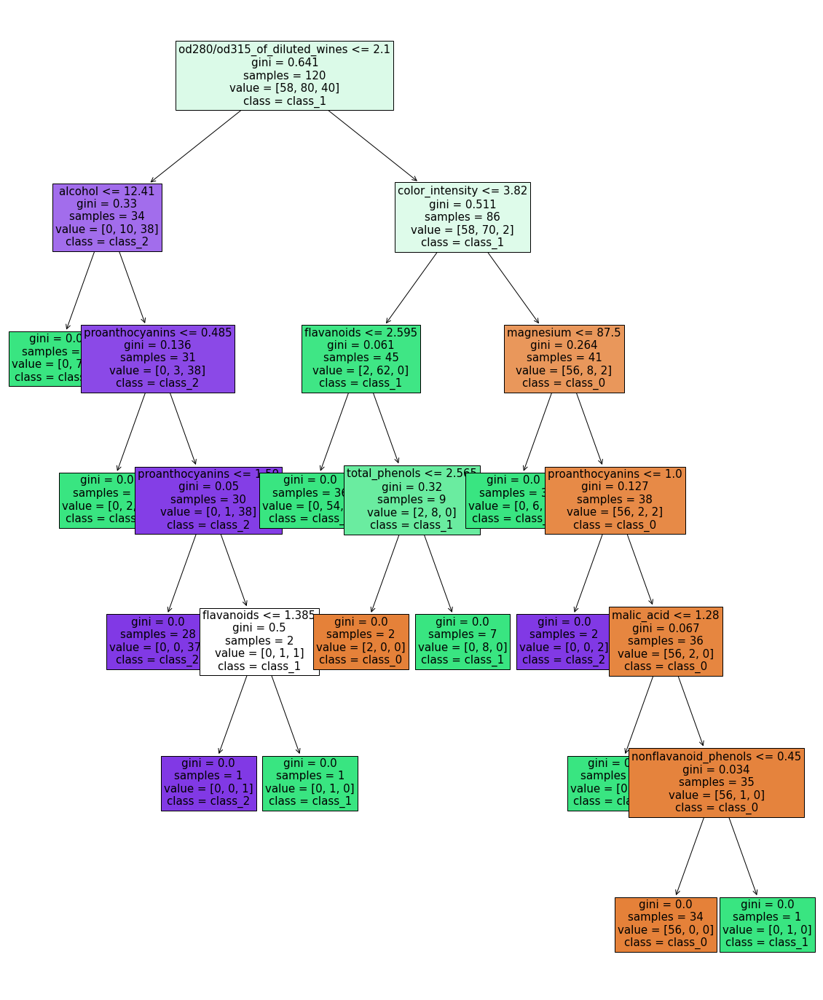

In [8]:
plt.figure(figsize=(20,25))
tree.plot_tree(rf.estimators_[0],feature_names=wine.feature_names,class_names=list(wine.target_names),filled=True,fontsize=15);
plt.show()

### Tree 2

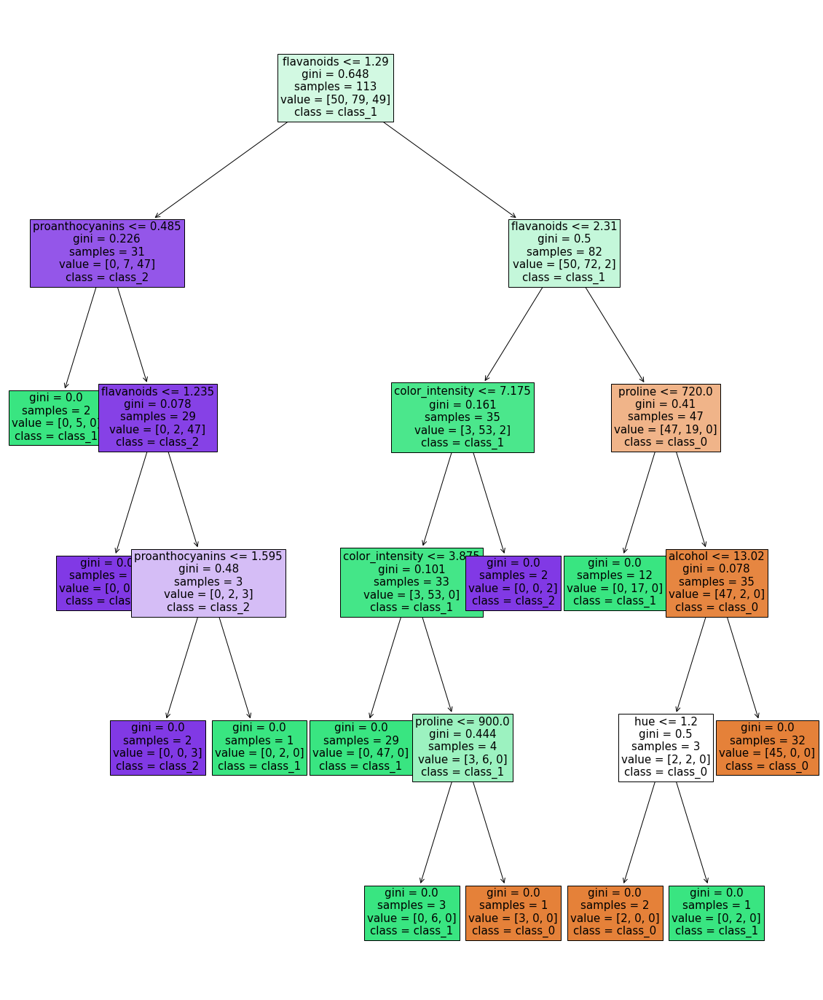

In [9]:
plt.figure(figsize=(20,25))
tree.plot_tree(rf.estimators_[1],feature_names=wine.feature_names,class_names=list(wine.target_names),filled=True,fontsize=15);
plt.show()

### Tree 3

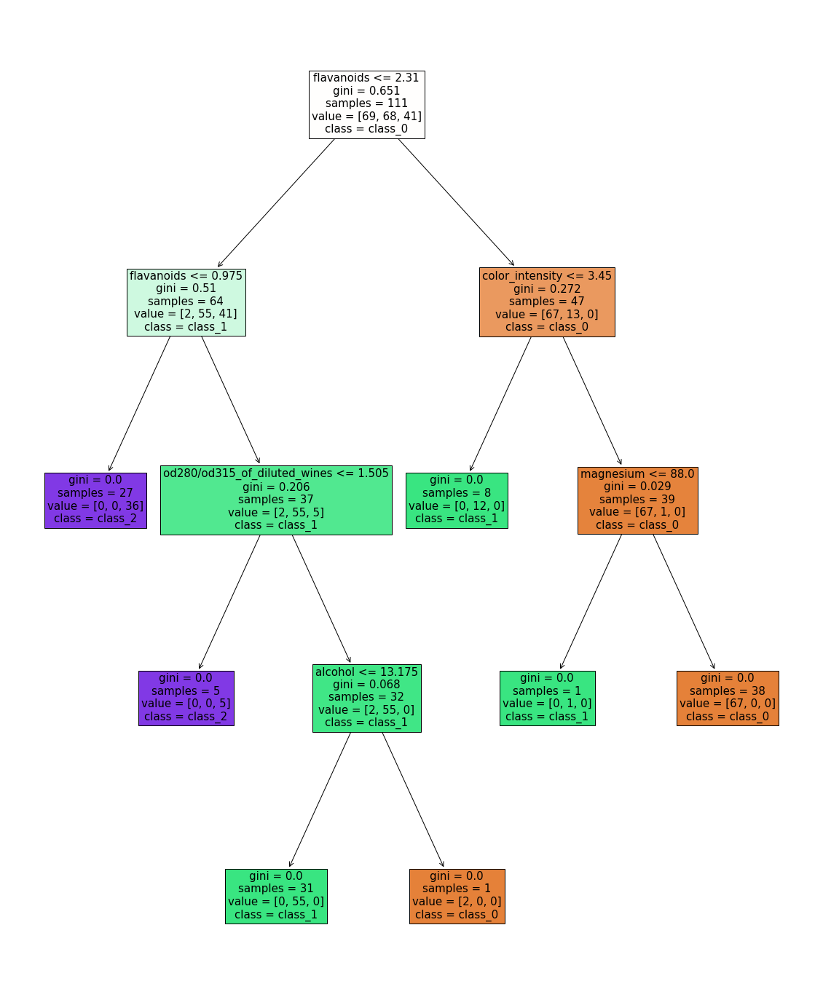

In [10]:
plt.figure(figsize=(20,25))
tree.plot_tree(rf.estimators_[2],feature_names=wine.feature_names,class_names=list(wine.target_names),filled=True,fontsize=15);
plt.show()

## 3. Plot Decision Tree with export_graphviz method

### Tree 1

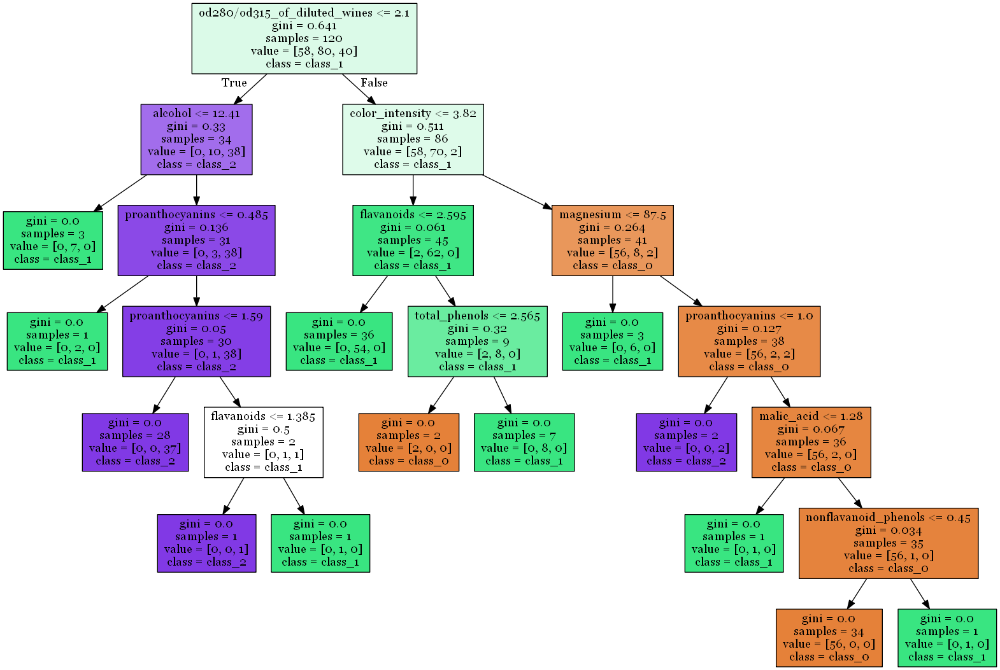

In [11]:
import graphviz
from IPython.display import display
import pydotplus

dot_data = tree.export_graphviz(rf.estimators_[0],feature_names=wine.feature_names,class_names=list(wine.target_names),filled=True,fontname=15)

graph = pydotplus.graph_from_dot_data(dot_data)  
graph.write_png("wine1.png")
# Show graph
Image(graph.create_png())


### Tree 2

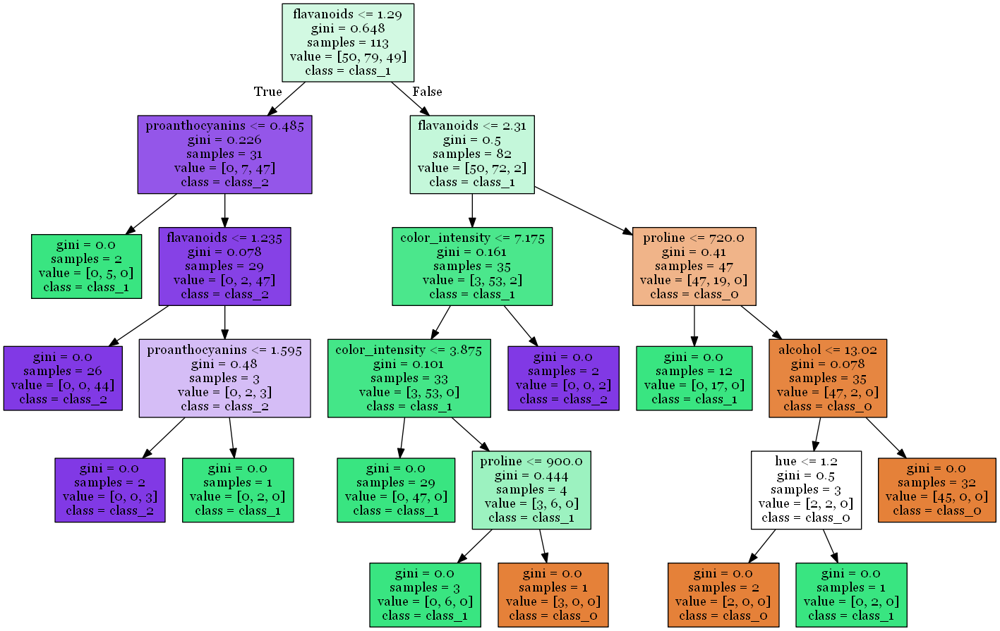

In [12]:
dot_data = tree.export_graphviz(rf.estimators_[1],feature_names=wine.feature_names,class_names=list(wine.target_names),filled=True,fontname=15)

#Draw graph
graph = graphviz.Source(dot_data,format='png')
graph.render("decision_tree2_graphivz")

graph = pydotplus.graph_from_dot_data(dot_data)  
graph.write_png("wine2.png")
# Show graph
Image(graph.create_png())


### Tree 3

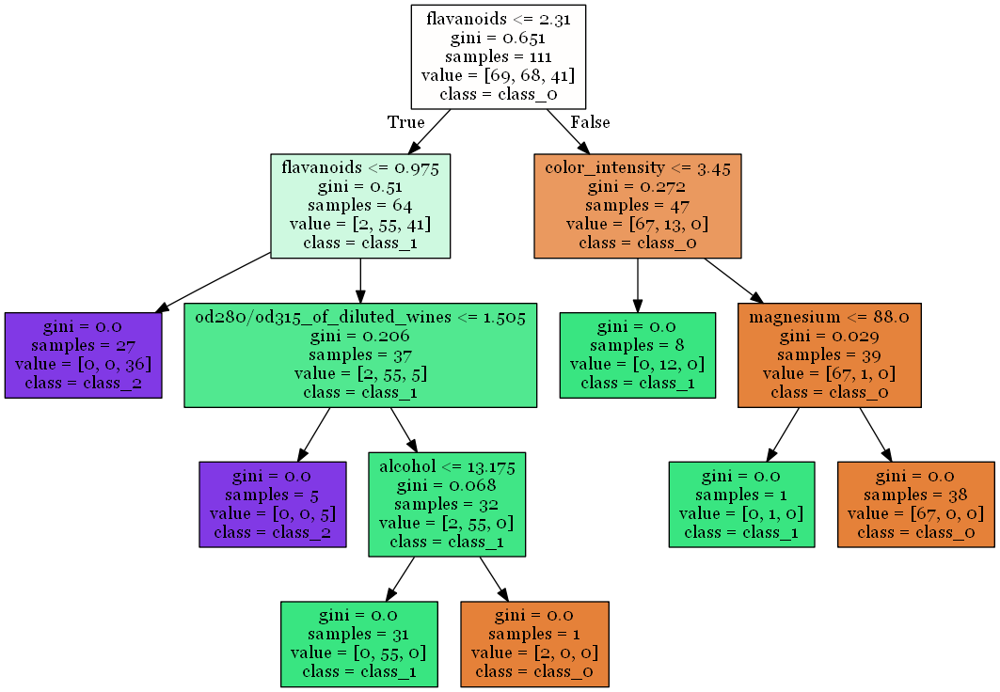

In [13]:

dot_data = tree.export_graphviz(rf.estimators_[2],feature_names=wine.feature_names,class_names=list(wine.target_names),filled=True,fontname=15)

#Draw graph
graph = graphviz.Source(dot_data,format='png')
graph = pydotplus.graph_from_dot_data(dot_data)  
graph.write_png("wine3.png")
# Show graph
Image(graph.create_png())


## 3. Plot Decision Tree with dtreeviz

### Tree 1

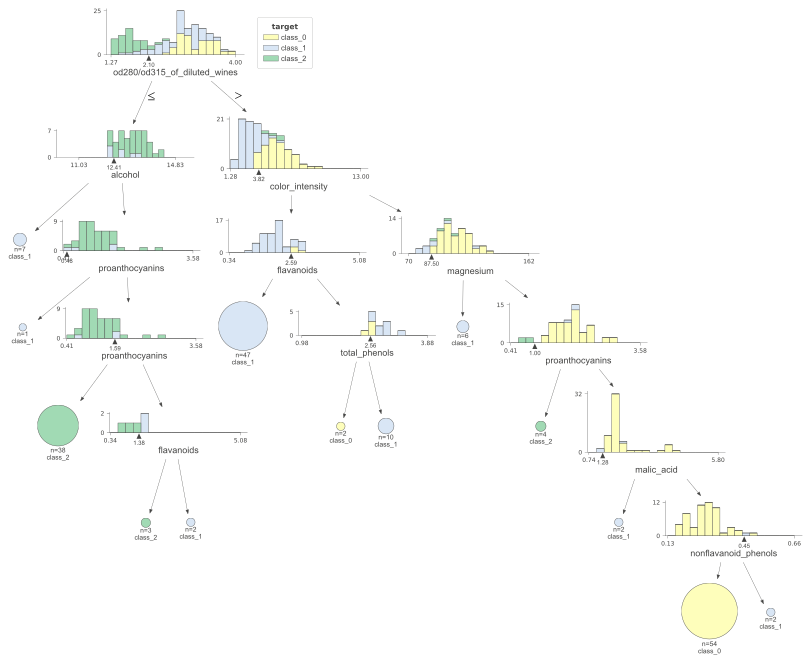

In [14]:
from dtreeviz.trees import dtreeviz
from IPython.display import Image, display_svg, SVG

viz = dtreeviz(rf.estimators_[0],x,y,target_name='target',feature_names = wine.feature_names,class_names=list(wine.target_names))
viz.save('RF_DT_1.svg')
viz


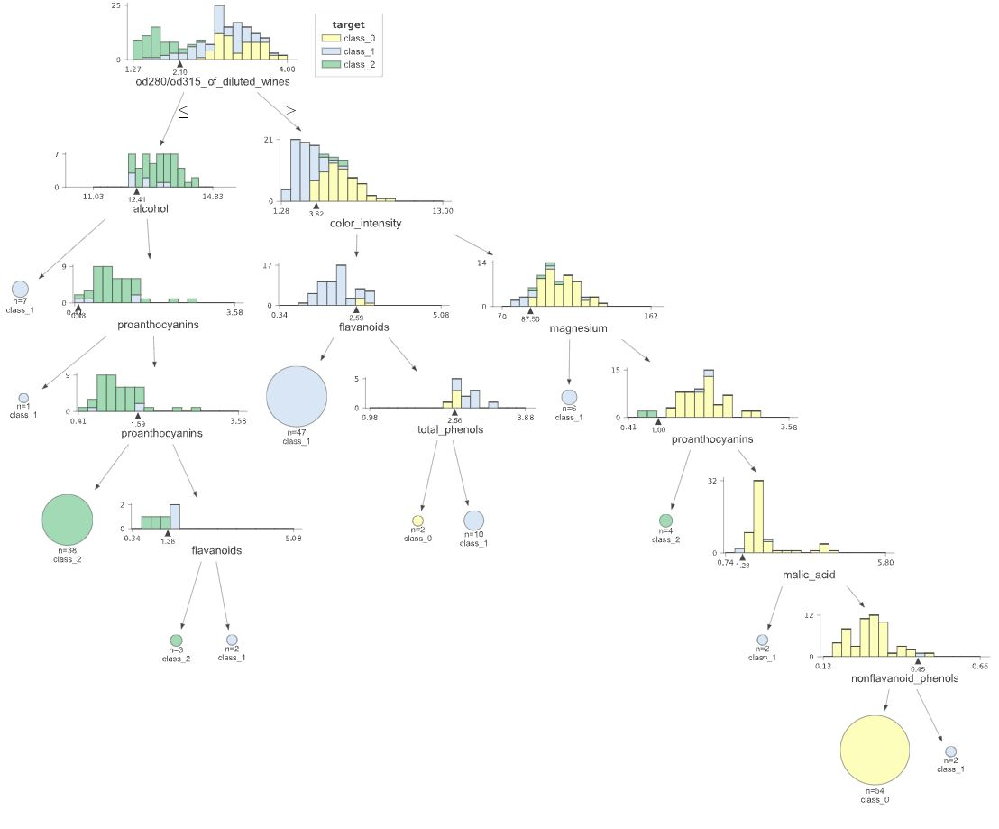

### Tree 2

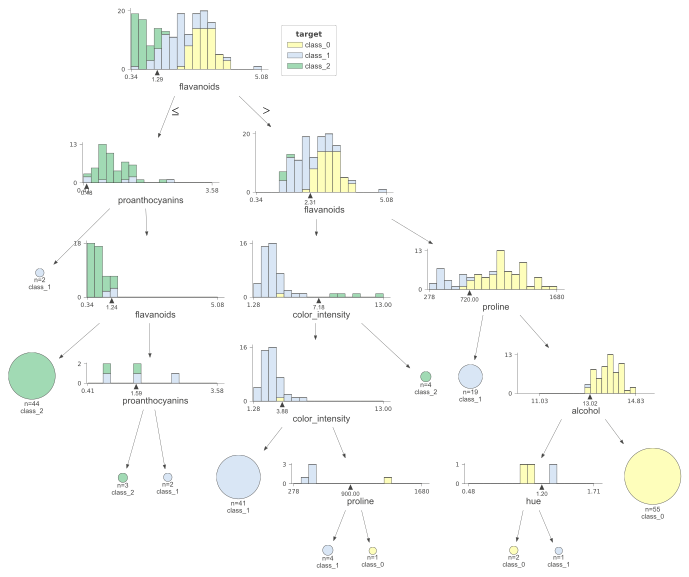

In [15]:
viz = dtreeviz(rf.estimators_[1],x,y,target_name='target',feature_names = wine.feature_names,class_names=list(wine.target_names))
viz.save('RF_DT_2.svg')
viz

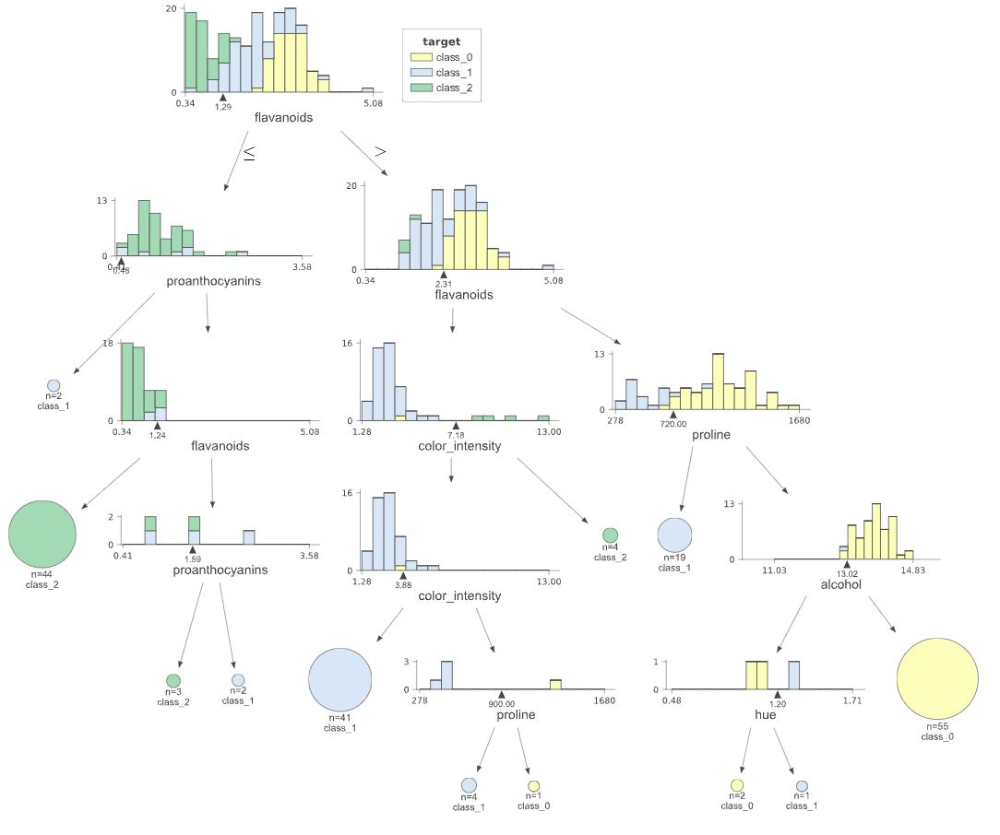

### Tree 3

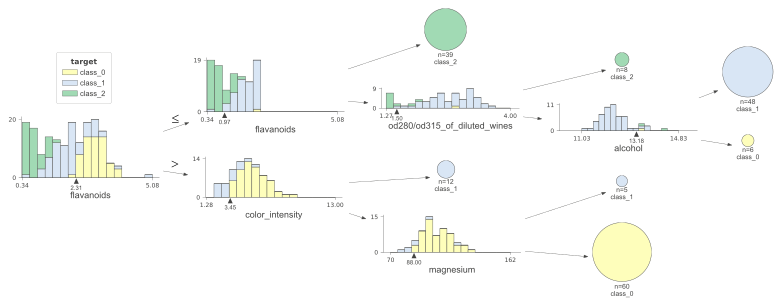

In [16]:
viz = dtreeviz(rf.estimators_[2],x,y,target_name='target',feature_names = wine.feature_names,class_names=list(wine.target_names),orientation = 'LR')
viz.save('RF_DT_3.svg')
viz

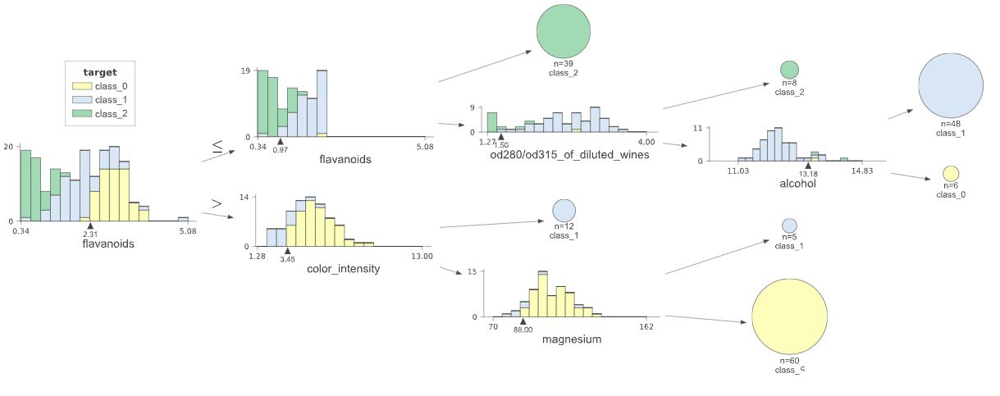

## Random forest on Regression task - Housing data set

In [17]:
from sklearn.ensemble import RandomForestRegressor

In [18]:
# prepare data
from sklearn.datasets import fetch_california_housing
housing = fetch_california_housing()
x = housing.data
y = housing.target

In [19]:
rf_reg = RandomForestRegressor(n_estimators=3,max_depth=3,random_state=42)
rf_reg.fit(x,y)

RandomForestRegressor(max_depth=3, n_estimators=3, random_state=42)

In [20]:
rf_reg.estimators_

[DecisionTreeRegressor(max_depth=3, max_features='auto', random_state=1608637542),
 DecisionTreeRegressor(max_depth=3, max_features='auto', random_state=1273642419),
 DecisionTreeRegressor(max_depth=3, max_features='auto', random_state=1935803228)]

## 1. Text Representation

### Tree 1

In [21]:
txt_rep = tree.export_text(rf_reg.estimators_[0],feature_names=housing.feature_names)
print(txt_rep)

|--- MedInc <= 5.59
|   |--- MedInc <= 3.13
|   |   |--- AveOccup <= 2.23
|   |   |   |--- value: [1.84]
|   |   |--- AveOccup >  2.23
|   |   |   |--- value: [1.27]
|   |--- MedInc >  3.13
|   |   |--- AveOccup <= 2.37
|   |   |   |--- value: [2.89]
|   |   |--- AveOccup >  2.37
|   |   |   |--- value: [1.97]
|--- MedInc >  5.59
|   |--- MedInc <= 7.65
|   |   |--- AveOccup <= 2.75
|   |   |   |--- value: [3.74]
|   |   |--- AveOccup >  2.75
|   |   |   |--- value: [2.92]
|   |--- MedInc >  7.65
|   |   |--- AveRooms <= 4.95
|   |   |   |--- value: [2.07]
|   |   |--- AveRooms >  4.95
|   |   |   |--- value: [4.53]



In [22]:
txt_rep = tree.export_text(rf_reg.estimators_[1],feature_names=housing.feature_names)
print(txt_rep)

|--- MedInc <= 5.10
|   |--- MedInc <= 3.15
|   |   |--- AveRooms <= 4.34
|   |   |   |--- value: [1.62]
|   |   |--- AveRooms >  4.34
|   |   |   |--- value: [1.19]
|   |--- MedInc >  3.15
|   |   |--- AveOccup <= 2.37
|   |   |   |--- value: [2.82]
|   |   |--- AveOccup >  2.37
|   |   |   |--- value: [1.90]
|--- MedInc >  5.10
|   |--- MedInc <= 6.87
|   |   |--- AveOccup <= 2.75
|   |   |   |--- value: [3.40]
|   |   |--- AveOccup >  2.75
|   |   |   |--- value: [2.57]
|   |--- MedInc >  6.87
|   |   |--- MedInc <= 8.12
|   |   |   |--- value: [3.86]
|   |   |--- MedInc >  8.12
|   |   |   |--- value: [4.68]



In [23]:
txt_rep = tree.export_text(rf_reg.estimators_[2],feature_names=housing.feature_names)
print(txt_rep)

|--- MedInc <= 5.09
|   |--- MedInc <= 3.18
|   |   |--- AveOccup <= 2.18
|   |   |   |--- value: [1.90]
|   |   |--- AveOccup >  2.18
|   |   |   |--- value: [1.29]
|   |--- MedInc >  3.18
|   |   |--- AveOccup <= 2.33
|   |   |   |--- value: [2.88]
|   |   |--- AveOccup >  2.33
|   |   |   |--- value: [1.92]
|--- MedInc >  5.09
|   |--- MedInc <= 6.88
|   |   |--- AveOccup <= 2.58
|   |   |   |--- value: [3.56]
|   |   |--- AveOccup >  2.58
|   |   |   |--- value: [2.68]
|   |--- MedInc >  6.88
|   |   |--- MedInc <= 7.82
|   |   |   |--- value: [3.75]
|   |   |--- MedInc >  7.82
|   |   |   |--- value: [4.56]



## 2 Plot Decision Tree with plot_tree method

### Tree 1

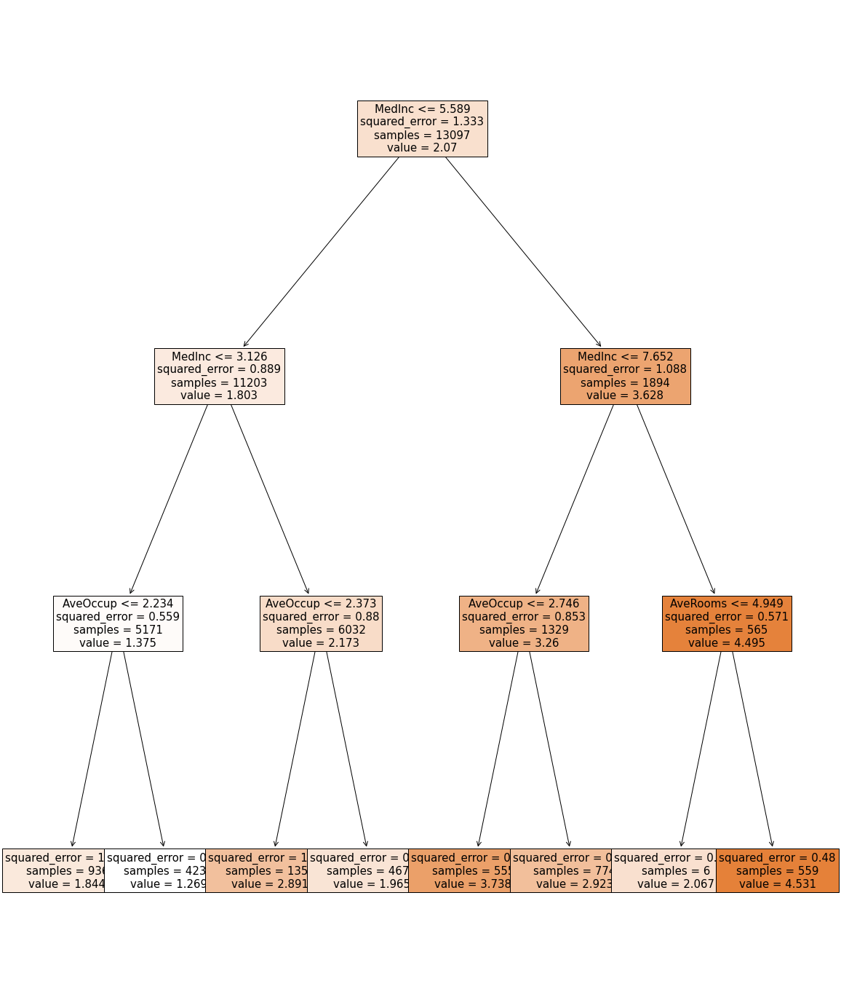

In [24]:
plt.figure(figsize=(20,25))
tree.plot_tree(rf_reg.estimators_[0],feature_names=housing.feature_names,filled=True,fontsize=15);
plt.show()

### Tree 2

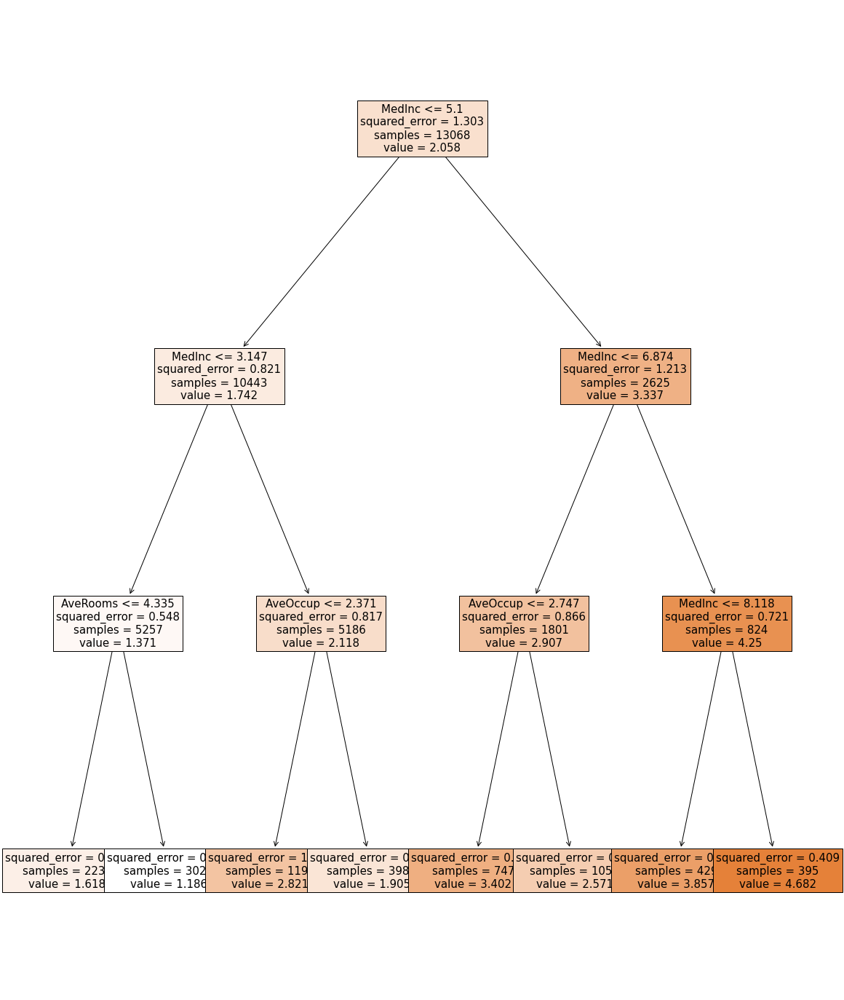

In [25]:
plt.figure(figsize=(20,25))
tree.plot_tree(rf_reg.estimators_[1],feature_names=housing.feature_names,filled=True,fontsize=15);
plt.show()

### Tree 3

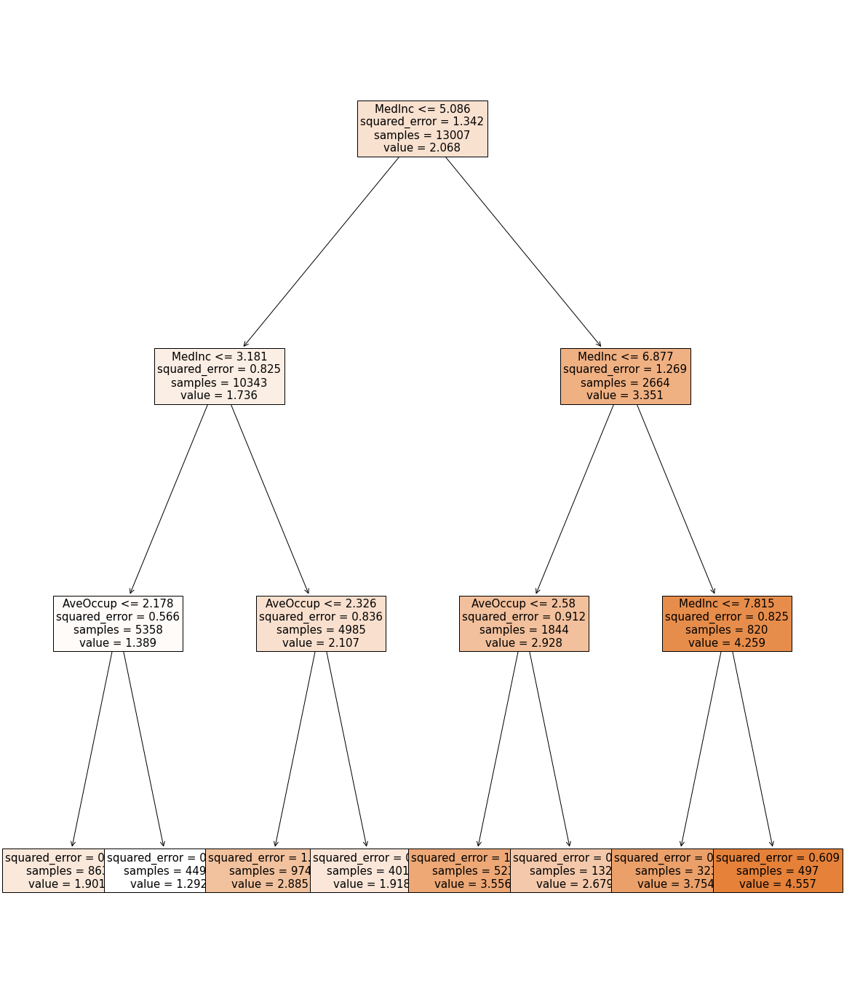

In [26]:
plt.figure(figsize=(20,25))
tree.plot_tree(rf_reg.estimators_[2],feature_names=housing.feature_names,filled=True,fontsize=15);
plt.show()

## 3. Plot Decision tree with export_graphviz method

### Tree 1

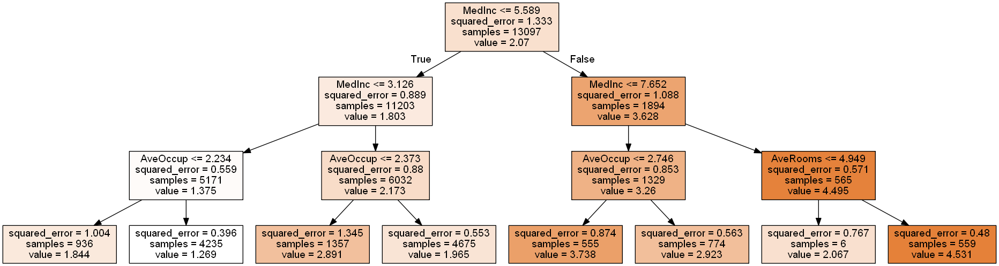

In [27]:
dot_data = tree.export_graphviz(rf_reg.estimators_[0],feature_names=housing.feature_names,class_names=list(housing.target_names),filled=True)

#Draw graph
graph = graphviz.Source(dot_data,format='png')
graph = pydotplus.graph_from_dot_data(dot_data)  
graph.write_png("hoising1.png")
# Show graph
Image(graph.create_png())

### Tree 2

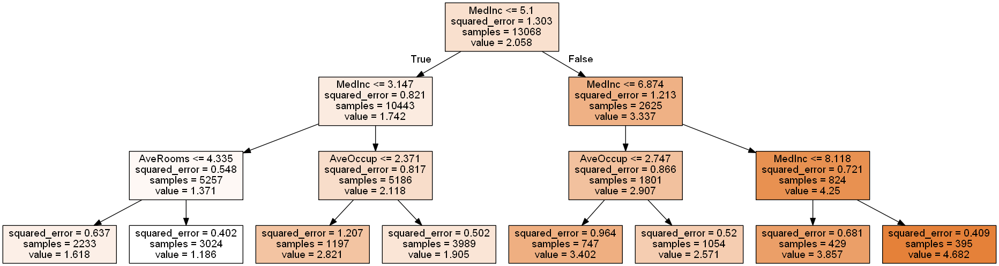

In [28]:
dot_data = tree.export_graphviz(rf_reg.estimators_[1],feature_names=housing.feature_names,class_names=list(housing.target_names),filled=True)

#Draw graph
graph = graphviz.Source(dot_data,format='png')
graph = pydotplus.graph_from_dot_data(dot_data)  
graph.write_png("housing2.png")
# Show graph
Image(graph.create_png())

### Tree 3

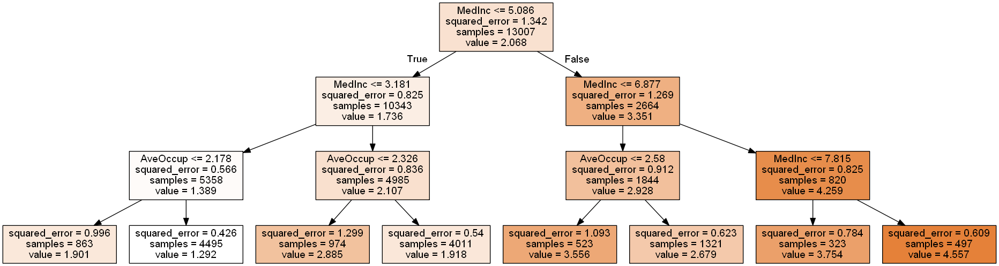

In [29]:
dot_data = tree.export_graphviz(rf_reg.estimators_[2],feature_names=housing.feature_names,class_names=list(housing.target_names),filled=True)

#Draw graph
graph = graphviz.Source(dot_data,format='png')
graph = pydotplus.graph_from_dot_data(dot_data)  
graph.write_png("housing3.png")
# Show graph
Image(graph.create_png())

##  4 Plot Decision tree with dtreeviz method

### Tree 1

In [30]:
viz = dtreeviz(rf_reg.estimators_[0], x, y,
                target_name="target",
                feature_names=housing.feature_names)
viz.save('RF_DT__Reg_1.svg')
viz

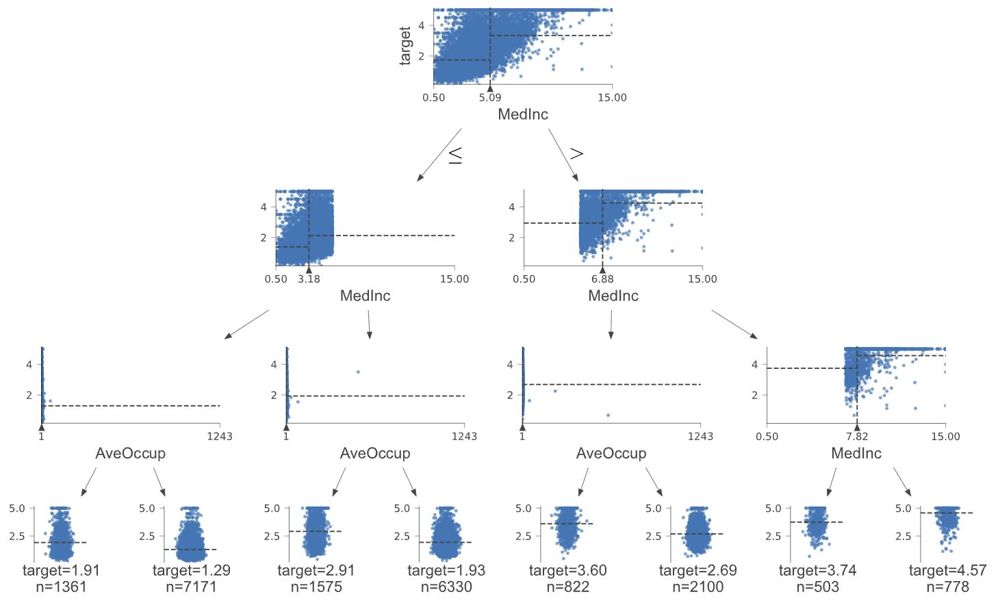

### Tree 2

In [31]:
viz = dtreeviz(rf_reg.estimators_[1], x, y,
                target_name="target",
                feature_names=housing.feature_names)

viz

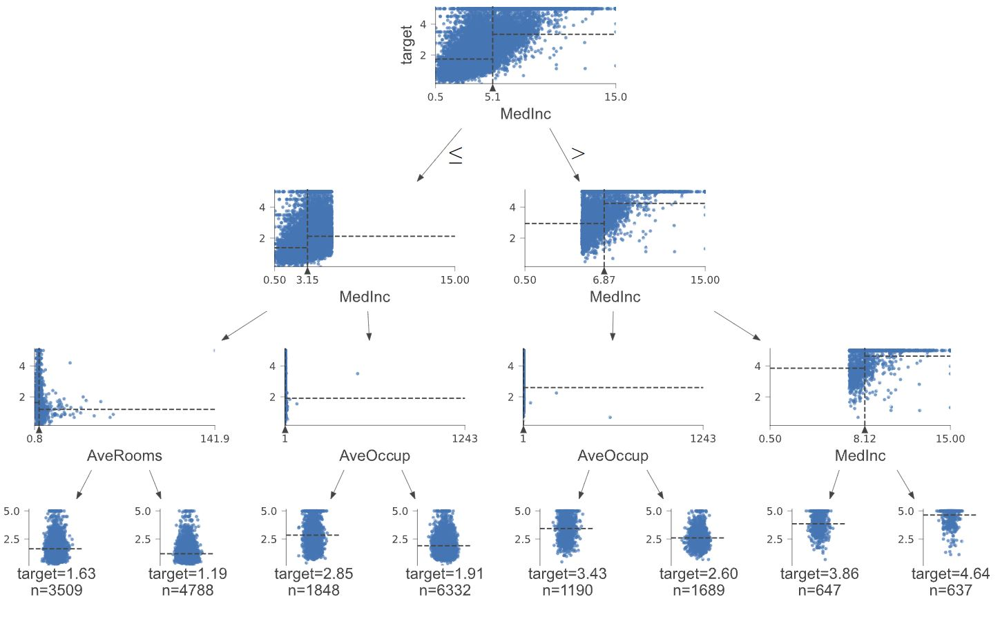

### Tree 3

In [32]:
viz = dtreeviz(rf_reg.estimators_[2], x, y,
                target_name="target",
                feature_names=housing.feature_names)
viz

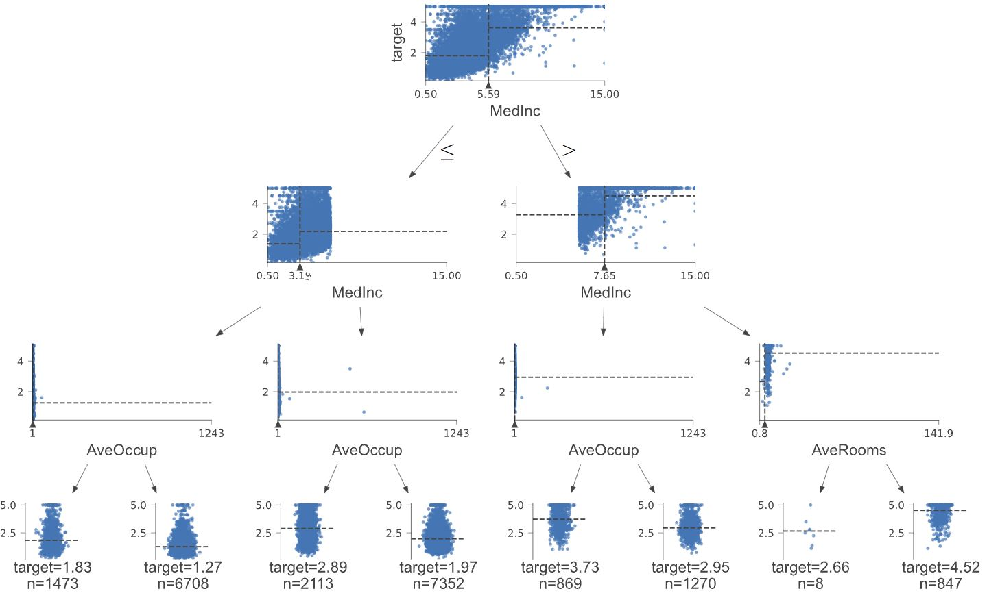

### Reference

- https://github.com/parrt/dtreeviz/blob/master/README.md
- https://explained.ai/decision-tree-viz/index.html


 ### Thank you